<a href="https://colab.research.google.com/github/ljtaylor99/AAI-500-Final-Project/blob/main/AAI_521_Final_Project.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [1]:
# Import libraries
!pip install opendatasets
import pandas as pd
import cv2
import json
import tensorflow as tf
from tensorflow import keras
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import opendatasets as od
import glob
import os
import re
import pathlib
import imgaug as ia
ia.seed(1)
# imgaug uses matplotlib backend for displaying images
%matplotlib inline
from imgaug.augmentables.bbs import BoundingBox, BoundingBoxesOnImage
from keras.preprocessing.image import ImageDataGenerator
from tensorflow.keras.preprocessing.image import img_to_array
from imgaug import augmenters as iaa
# imageio library will be used for image input/output
import imageio
import PIL
from PIL import Image
import PIL.Image
import PIL.ImageShow
from google.colab.patches import cv2_imshow
import xml.etree.ElementTree as ET
import shutil
import warnings
warnings.simplefilter(action='ignore', category=FutureWarning)
warnings.simplefilter(action='ignore', category=DeprecationWarning)

In [2]:
# Download datset from Kaggle to notebook directory
# https://www.geeksforgeeks.org/how-to-import-kaggle-datasets-directly-into-google-colab/
od.download('https://www.kaggle.com/datasets/responsibleailab/crop-disease-ghana')

Please provide your Kaggle credentials to download this dataset. Learn more: http://bit.ly/kaggle-creds
Your Kaggle username: lauren0831
Your Kaggle Key: ··········


100%|██████████| 18.7G/18.7G [13:19<00:00, 25.1MB/s]


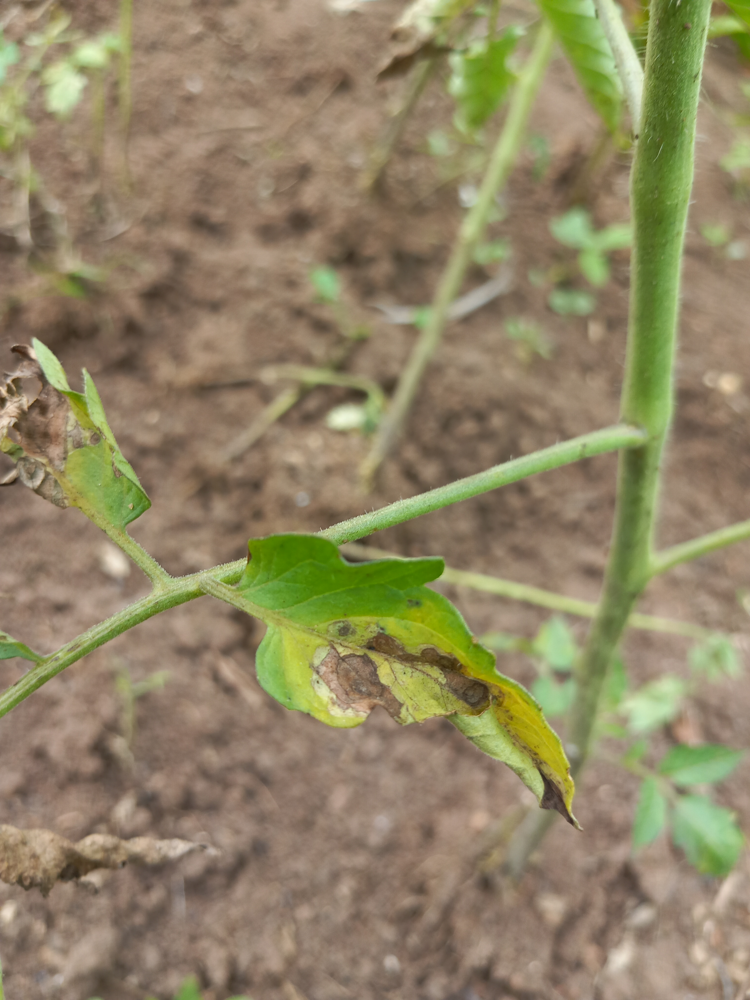

In [3]:
# Print out test image
test_img = '/content/crop-disease-ghana/input/Tomato/Tomato__Early_Blight/images/20230518_134246.jpg'
test_img = cv2.imread(test_img)
cv2_imshow(test_img)

In [4]:
# Show files in directory
os.listdir('/content/crop-disease-ghana/input')

['catyegory_index.pbtxt',
 'label_map.txt',
 'Corn',
 'dataset_labels.csv',
 'label_map.json',
 'Tomato',
 'label_map.pbtxt',
 'Pepper']

In [5]:
# Read csv file with data labels
labels_df = pd.read_csv('/content/crop-disease-ghana/input/dataset_labels.csv')
labels_df.head()

,filename,disease,crop,width,height,depth,xmin,ymin,xmax,ymax,ann_path,img_path
0,20230524_104642.jpg,Corn Cercospora Leaf Spot,Corn,4080,1836,3,2052.653343,695.836619,2210.117161,785.809054,input\Corn\Corn__Cercospora_Leaf_Spot\annotati...,input\Corn\Corn__Cercospora_Leaf_Spot\images\2...
1,20230524_104642.jpg,Corn Cercospora Leaf Spot,Corn,4080,1836,3,1110.682288,901.086237,1228.780152,982.623756,input\Corn\Corn__Cercospora_Leaf_Spot\annotati...,input\Corn\Corn__Cercospora_Leaf_Spot\images\2...
2,20230524_104642.jpg,Corn Cercospora Leaf Spot,Corn,4080,1836,3,1647.746382,912.332791,1791.150930,1002.305226,input\Corn\Corn__Cercospora_Leaf_Spot\annotati...,input\Corn\Corn__Cercospora_Leaf_Spot\images\2...
3,20230524_104642.jpg,Corn Cercospora Leaf Spot,Corn,4080,1836,3,2491.302550,1275.034169,2589.717436,1367.818243,input\Corn\Corn__Cercospora_Leaf_Spot\annotati...,input\Corn\Corn__Cercospora_Leaf_Spot\images\2...
4,20230524_104642.jpg,Corn Cercospora Leaf Spot,Corn,4080,1836,3,3326.423156,1255.352699,3410.778773,1339.701857,input\Corn\Corn__Cercospora_Leaf_Spot\annotati...,input\Corn\Corn__Cercospora_Leaf_Spot\images\2...


In [6]:
# Merge similar classes
labels_df.replace(['Pepper Late Blight','Pepper Early Blight'],'Pepper Leaf Blight',inplace = True)
labels_df.replace(['Tomato Late Blight','Tomato Early Blight'],'Tomato Leaf Blight',inplace = True)

In [7]:
# Drop labels with too little data or multiple diseases
labels_df = labels_df[labels_df['disease'] != 'Tomato Mosaic']
labels_df = labels_df[labels_df['disease'] != 'Corn Northern Leaf Blight']
labels_df = labels_df[labels_df['disease'] != 'Pepper Leaf Mosaic']
labels_df['disease'].value_counts()

Corn Cercospora Leaf Spot    9431
Tomato Septoria              9211
Tomato Leaf Blight           7993
Corn Streak                  4591
Tomato Healthy               4066
Pepper Septoria              3222
Pepper Bacterial Spot        2780
Corn Common Rust             2434
Corn Healthy                 2304
Pepper Leaf Curl             2175
Pepper Leaf Blight           1660
Tomato Fusarium              1238
Pepper Healthy               1049
Pepper Cercospora             704
Pepper Fusarium               696
Tomato Leaf Curl              641
Tomato Bacterial Spot         639
Name: disease, dtype: int64

In [8]:
# Labels for categories
labels = {}
#np.unique(no_duplicates['disease'])
lab_len = len(np.unique(labels_df['disease']))
for j,i in zip(np.unique(labels_df['disease']),range(1,lab_len + 1)):
  labels[j] = i
print(labels)

{'Corn Cercospora Leaf Spot': 1, 'Corn Common Rust': 2, 'Corn Healthy': 3, 'Corn Streak': 4, 'Pepper Bacterial Spot': 5, 'Pepper Cercospora': 6, 'Pepper Fusarium': 7, 'Pepper Healthy': 8, 'Pepper Leaf Blight': 9, 'Pepper Leaf Curl': 10, 'Pepper Septoria': 11, 'Tomato Bacterial Spot': 12, 'Tomato Fusarium': 13, 'Tomato Healthy': 14, 'Tomato Leaf Blight': 15, 'Tomato Leaf Curl': 16, 'Tomato Septoria': 17}


In [9]:
# Use categorical labels to make new target column
enc_labels = []
for i in labels_df['disease']:
  for k,v in labels.items():
    if i == k :
      enc_labels.append(labels[i])
labels_df['label'] = enc_labels
labels_df.head()

,filename,disease,crop,width,height,depth,xmin,ymin,xmax,ymax,ann_path,img_path,label
0,20230524_104642.jpg,Corn Cercospora Leaf Spot,Corn,4080,1836,3,2052.653343,695.836619,2210.117161,785.809054,input\Corn\Corn__Cercospora_Leaf_Spot\annotati...,input\Corn\Corn__Cercospora_Leaf_Spot\images\2...,1
1,20230524_104642.jpg,Corn Cercospora Leaf Spot,Corn,4080,1836,3,1110.682288,901.086237,1228.780152,982.623756,input\Corn\Corn__Cercospora_Leaf_Spot\annotati...,input\Corn\Corn__Cercospora_Leaf_Spot\images\2...,1
2,20230524_104642.jpg,Corn Cercospora Leaf Spot,Corn,4080,1836,3,1647.746382,912.332791,1791.150930,1002.305226,input\Corn\Corn__Cercospora_Leaf_Spot\annotati...,input\Corn\Corn__Cercospora_Leaf_Spot\images\2...,1
3,20230524_104642.jpg,Corn Cercospora Leaf Spot,Corn,4080,1836,3,2491.302550,1275.034169,2589.717436,1367.818243,input\Corn\Corn__Cercospora_Leaf_Spot\annotati...,input\Corn\Corn__Cercospora_Leaf_Spot\images\2...,1
4,20230524_104642.jpg,Corn Cercospora Leaf Spot,Corn,4080,1836,3,3326.423156,1255.352699,3410.778773,1339.701857,input\Corn\Corn__Cercospora_Leaf_Spot\annotati...,input\Corn\Corn__Cercospora_Leaf_Spot\images\2...,1


In [10]:
# Fix img path
loc_path = '/content/crop-disease-ghana/'
new_img = []
for txt in labels_df['img_path']:
  n = loc_path + txt.replace('\\','/')
  new_img.append(n)
labels_df['img_path'] = new_img
labels_df['img_path'][0]

'/content/crop-disease-ghana/input/Corn/Corn__Cercospora_Leaf_Spot/images/20230524_104642.jpg'

In [11]:
# Fix annotation path
loc_path = '/content/crop-disease-ghana/'
new_ann = []
for txt in labels_df['ann_path']:
  a = loc_path + txt.replace('\\','/')
  new_ann.append(a)
labels_df['ann_path'] = new_ann
labels_df['ann_path'][0]

'/content/crop-disease-ghana/input/Corn/Corn__Cercospora_Leaf_Spot/annotations/20230524_104642.xml'

In [12]:
# Drop duplicates
no_duplicates = labels_df.drop_duplicates(subset = 'img_path',ignore_index=True)
no_duplicates.reset_index()
no_duplicates.shape

(6919, 13)

<Axes: xlabel='crop', ylabel='count'>

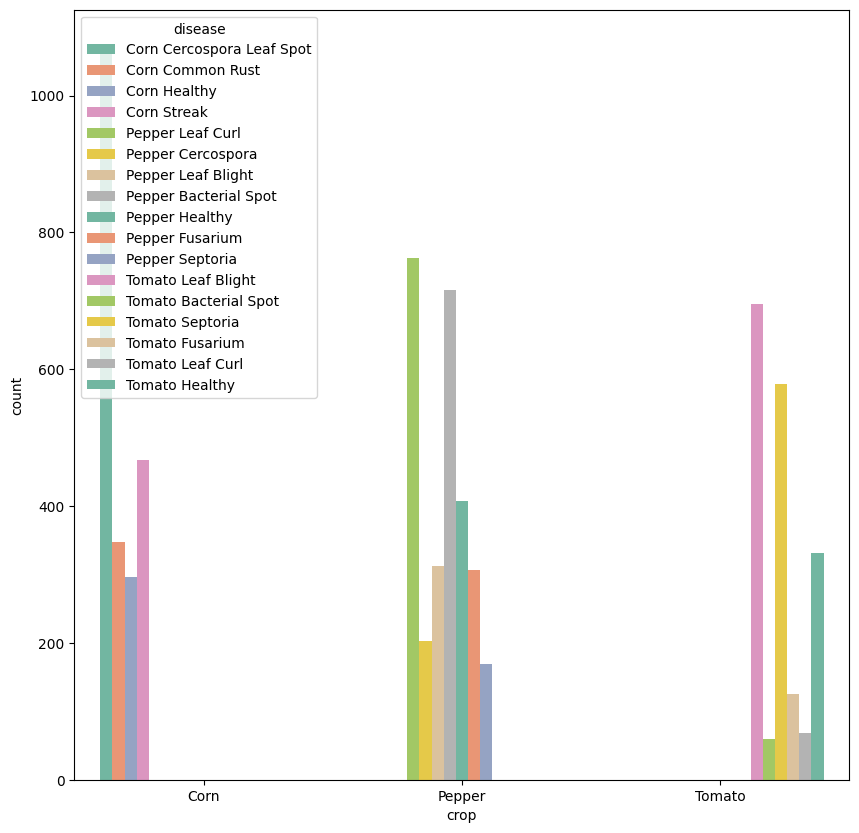

In [13]:
# Crop type and disease distribution
plt.figure(figsize = (10,10))
sns.countplot(x = no_duplicates['crop'],hue = no_duplicates['disease'],palette = 'Set2')

In [14]:
# Disease value counts
no_duplicates['disease'].value_counts()

Corn Cercospora Leaf Spot    1072
Pepper Leaf Curl              763
Pepper Bacterial Spot         716
Tomato Leaf Blight            696
Tomato Septoria               579
Corn Streak                   467
Pepper Healthy                408
Corn Common Rust              348
Tomato Healthy                331
Pepper Leaf Blight            312
Pepper Fusarium               306
Corn Healthy                  296
Pepper Cercospora             203
Pepper Septoria               169
Tomato Fusarium               126
Tomato Leaf Curl               68
Tomato Bacterial Spot          59
Name: disease, dtype: int64

### Looks like there is class imbalance. In order to address this problem, there should be a combination of resampling and data augmentation.

In [16]:
# Modifed from:
# https://medium.com/@a.karazhay/guide-augment-images-and-multiple-bounding-boxes-for-deep-learning-in-4-steps-with-the-notebook-9b263e414dac
# function to convert BoundingBoxesOnImage object into DataFrame
def bbs_obj_to_df(bbs_object):
#     convert BoundingBoxesOnImage object into array
    bbs_array = bbs_object.to_xyxy_array()
#     convert array into a DataFrame ['xmin', 'ymin', 'xmax', 'ymax'] columns
    df_bbs = pd.DataFrame(bbs_array, columns=['xmin', 'ymin', 'xmax', 'ymax'])
    return df_bbs

def image_aug(df,aug_images_path, image_prefix, augmentor,ref_df):
    # create data frame which we're going to populate with augmented image info
    aug_bbs_xy = pd.DataFrame(columns=labels_df.columns)
    grouped = df.groupby('filename')
    for filename,i in zip(df['filename'].unique(),range(len(df))):
    #   get separate data frame grouped by file name
        group_df = grouped.get_group(filename)
        group_df = group_df.reset_index()
        group_df = group_df.drop(['index'], axis=1)
    #   read the image
        image = imageio.imread(ref_df['img_path'][i])
    #   get bounding boxes coordinates and write into array
        bb_array = group_df.drop(['filename', 'disease', 'crop', 'width', 'height', 'depth',
                                  'ann_path', 'img_path','label'], axis=1).values
    #   pass the array of bounding boxes coordinates to the imgaug library
        bbs = BoundingBoxesOnImage.from_xyxy_array(bb_array, shape=image.shape)
    #   apply augmentation on image and on the bounding boxes
        image_aug, bbs_aug = augmentor(image=image, bounding_boxes=bbs)
    #   disregard bounding boxes which have fallen out of image pane
        bbs_aug = bbs_aug.remove_out_of_image()
    #   clip bounding boxes which are partially outside of image pane
        bbs_aug = bbs_aug.clip_out_of_image()

    #   don't perform any actions with the image if there are no bounding boxes left in it
        if re.findall('Image...', str(bbs_aug)) == ['Image([]']:
            pass

    #   otherwise continue
        else:
        #   write augmented image to a file
            os.chdir(aug_images_path)
            name = image_prefix+'_'+filename
            cv2.imwrite(name, image_aug)
            #imageio.imwrite(aug_images_path, image_aug,plugin='DICOM')
        #   create a data frame with augmented values of image width and height
            info_df = group_df.drop(['xmin', 'ymin', 'xmax', 'ymax'], axis=1)
            for index, _ in info_df.iterrows():
                info_df.at[index, 'width'] = image_aug.shape[1]
                info_df.at[index, 'height'] = image_aug.shape[0]
        #   rename filenames by adding the predifined prefix
            #info_df['filename'] = info_df['filename'].replace(info_df['filename'][i],name)
            info_df['filename'] = info_df['filename'].apply(lambda x: image_prefix+'_'+x)
        #   create a data frame with augmented bounding boxes coordinates using the function we created earlier
            bbs_df = bbs_obj_to_df(bbs_aug)
        #   concat all new augmented info into new data frame
            aug_df = pd.concat([info_df, bbs_df], axis=1)
        #   append rows to aug_bbs_xy data frame
            aug_bbs_xy = pd.concat([aug_bbs_xy, aug_df])

    # return dataframe with updated images and bounding boxes annotations
    aug_bbs_xy = aug_bbs_xy.reset_index()
    aug_bbs_xy = aug_bbs_xy.drop(['index'], axis=1)
    return aug_bbs_xy


In [17]:
# Augmentors to use
aug_flip = iaa.Sequential([
    iaa.Fliplr(1)
])
aug_rotate = iaa.Sequential([
    iaa.Affine(rotate=(-60, 60))
])

aug_blur = iaa.Sequential([
    iaa.GaussianBlur(sigma=(2.0, 3.0))
])

aug_noise = iaa.Sequential([
  iaa.AdditiveGaussianNoise(scale=(0.03*255, 0.05*255))
])

In [18]:
# Going to augment rare classes the append augmented data to labels_df
tlc_df = labels_df[labels_df['disease']=='Tomato Leaf Curl'].reset_index()
tbs_df = labels_df[labels_df['disease']=='Tomato Bacterial Spot'].reset_index()
pc_df = labels_df[labels_df['disease']=='Pepper Cercospora'].reset_index()
ps_df = labels_df[labels_df['disease']=='Pepper Septoria'].reset_index()
tf_df = labels_df[labels_df['disease']=='Tomato Fusarium'].reset_index()

# Make folders to store augmented images
!mkdir Tomato_Leaf_Curl_Aug
!mkdir Tomato_Bacterial_Spot_Aug
!mkdir Pepper_Cercospora
!mkdir Pepper_Septoria
!mkdir Tomato_Fusarium

In [19]:
# Create augmented data set
def make_aug(df,aug_dir):
  aug_list = [aug_flip,aug_rotate,aug_blur,aug_noise]

  aug_df = image_aug(df[labels_df.columns],
                   aug_dir, 'flip', aug_list[0],df)
  label = ['rotate','blur','noise']
  for a,n in zip(aug_list[1:],label):
    aug_df = aug_df.append(image_aug(df[labels_df.columns],
                   aug_dir, n, a,df))
  # Drop rows with null
  aug_df = aug_df.dropna()
  return aug_df

In [20]:
# Make augmented datasets
tlc_aug = make_aug(tlc_df,'/content/Tomato_Leaf_Curl_Aug').reset_index()
tbs_aug = make_aug(tbs_df,'/content/Tomato_Bacterial_Spot_Aug').reset_index()
pc_aug = make_aug(pc_df,'/content/Pepper_Cercospora').reset_index()
ps_aug = make_aug(ps_df,'/content/Pepper_Septoria').reset_index()
tf_aug = make_aug(tf_df,'/content/Tomato_Fusarium').reset_index()

In [21]:
# Number of unique augmented images
print(len(tlc_aug['filename'].unique()))
print(len(tbs_aug['filename'].unique()))
print(len(pc_aug['filename'].unique()))
print(len(ps_aug['filename'].unique()))
print(len(tf_aug['filename'].unique()))

380
371
893
666
456


In [22]:
print(len(os.listdir('/content/Tomato_Leaf_Curl_Aug')))
print(len(os.listdir('/content/Tomato_Bacterial_Spot_Aug')))
print(len(os.listdir('/content/Pepper_Cercospora')))
print(len(os.listdir('/content/Pepper_Septoria')))
print(len(os.listdir('/content/Tomato_Fusarium')))

380
371
893
666
456


In [23]:
tlc_aug

,index,filename,disease,crop,width,height,depth,xmin,ymin,xmax,ymax,ann_path,img_path,label
0,0,flip_IMG_3011.jpeg,Tomato Leaf Curl,Tomato,4032,3024,3,1533.429932,1586.780884,1840.773926,2167.487305,/content/crop-disease-ghana/input/Tomato/Tomat...,/content/crop-disease-ghana/input/Tomato/Tomat...,16
1,1,flip_IMG_3011.jpeg,Tomato Leaf Curl,Tomato,4032,3024,3,618.202393,1597.042847,1096.607178,2033.170288,/content/crop-disease-ghana/input/Tomato/Tomat...,/content/crop-disease-ghana/input/Tomato/Tomat...,16
2,2,flip_IMG_3011.jpeg,Tomato Leaf Curl,Tomato,4032,3024,3,2577.438477,902.496277,2912.614014,1354.034424,/content/crop-disease-ghana/input/Tomato/Tomat...,/content/crop-disease-ghana/input/Tomato/Tomat...,16
3,3,flip_IMG_3011.jpeg,Tomato Leaf Curl,Tomato,4032,3024,3,1315.911865,1372.759277,1736.795410,1517.977295,/content/crop-disease-ghana/input/Tomato/Tomat...,/content/crop-disease-ghana/input/Tomato/Tomat...,16
4,4,flip_IMG_3011.jpeg,Tomato Leaf Curl,Tomato,4032,3024,3,2185.676270,1207.585449,2512.000732,1416.671509,/content/crop-disease-ghana/input/Tomato/Tomat...,/content/crop-disease-ghana/input/Tomato/Tomat...,16
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2037,608,noise_IMG_6338.jpeg,Tomato Leaf Curl,Tomato,4032,3024,3,1028.479126,1204.349365,1341.086914,1680.833008,/content/crop-disease-ghana/input/Tomato/Tomat...,/content/crop-disease-ghana/input/Tomato/Tomat...,16
2038,609,noise_IMG_6338.jpeg,Tomato Leaf Curl,Tomato,4032,3024,3,1344.737549,1080.954346,1670.703003,1579.776611,/content/crop-disease-ghana/input/Tomato/Tomat...,/content/crop-disease-ghana/input/Tomato/Tomat...,16
2039,610,noise_IMG_6338.jpeg,Tomato Leaf Curl,Tomato,4032,3024,3,1756.864746,1533.190552,2336.005615,1964.180786,/content/crop-disease-ghana/input/Tomato/Tomat...,/content/crop-disease-ghana/input/Tomato/Tomat...,16
2040,611,noise_IMG_6338.jpeg,Tomato Leaf Curl,Tomato,4032,3024,3,1193.307983,1764.461060,1431.701294,2077.616699,/content/crop-disease-ghana/input/Tomato/Tomat...,/content/crop-disease-ghana/input/Tomato/Tomat...,16


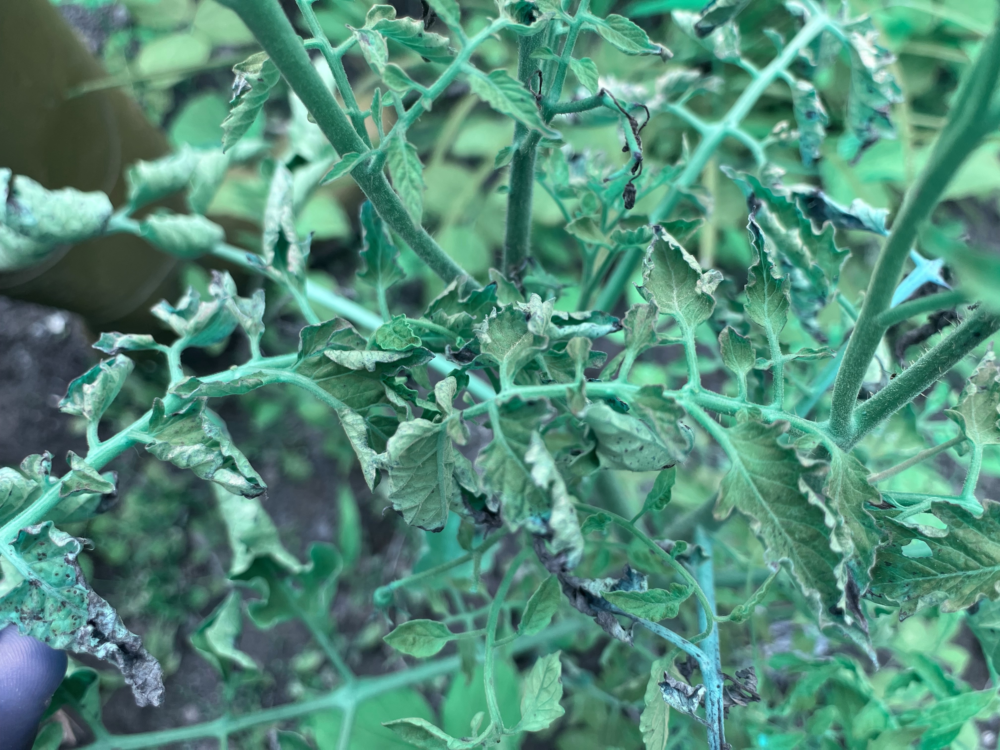

In [24]:
p = '/content/Tomato_Leaf_Curl_Aug/' + tlc_aug['filename'][0]
cv2_imshow(cv2.imread(p))

In [25]:
# Replace image paths
tlc_aug['img_path'] = '/content/Tomato_Leaf_Curl_Aug/' + tlc_aug['filename']
tbs_aug['img_path'] = '/content/Tomato_Bacterial_Spot_Aug/' + tbs_aug['filename']
pc_aug['img_path'] = '/content/Pepper_Cercospora/' + pc_aug['filename']
ps_aug['img_path'] = '/content/Pepper_Septoria/' + ps_aug['filename']
tf_aug['img_path'] = '/content/Tomato_Fusarium/' + tf_aug['filename']


In [26]:
# Drop index column
tlc_aug = tlc_aug.drop(labels = 'index',axis = 1)
tbs_aug = tbs_aug.drop(labels = 'index',axis = 1)
pc_aug = pc_aug.drop(labels = 'index',axis = 1)
ps_aug = ps_aug.drop(labels = 'index',axis = 1)
tf_aug = tf_aug.drop(labels = 'index',axis = 1)

In [27]:
# Append to labels_df
labels_df = labels_df.append(tlc_aug)
labels_df = labels_df.append(tbs_aug)
labels_df = labels_df.append(pc_aug)
labels_df = labels_df.append(pc_aug)
labels_df = labels_df.reset_index()

In [28]:
# Drop duplicates
no_duplicates = labels_df.drop_duplicates(subset = 'filename',ignore_index=True)
no_duplicates.reset_index()
no_duplicates.shape

(8081, 14)

In [30]:
# Create final balanced dataset
balanced = pd.DataFrame(columns = labels_df.columns)
for i in no_duplicates['disease'].unique():
  df = no_duplicates[no_duplicates['disease'] == i]
  if len(df)>300:
    samp = df.sample(n = 300,random_state = 24)
    balanced = balanced.append(samp)
  else:
    balanced = balanced.append(df)

In [31]:
balanced['disease'].value_counts()

Corn Cercospora Leaf Spot    300
Pepper Bacterial Spot        300
Tomato Leaf Curl             300
Tomato Septoria              300
Tomato Bacterial Spot        300
Tomato Leaf Blight           300
Pepper Fusarium              300
Pepper Healthy               300
Pepper Leaf Blight           300
Pepper Cercospora            300
Pepper Leaf Curl             300
Corn Streak                  300
Tomato Healthy               300
Corn Healthy                 280
Corn Common Rust             241
Pepper Septoria              169
Tomato Fusarium              126
Name: disease, dtype: int64

In [33]:
# Create final balanced df
balanced_df = pd.DataFrame(columns = balanced.columns)
for i in balanced['filename'].unique():
  x = labels_df[labels_df['filename'] == i]
  balanced_df = balanced_df.append(x)
balanced_df = balanced_df.reset_index()
#balanced_df = balanced_df.drop(labels = ['index','level_0'],axis = 1)
balanced_df.head()

,level_0,index,filename,disease,crop,width,height,depth,xmin,ymin,xmax,ymax,ann_path,img_path,label
0,4228,4228,20230525_111632.jpg,Corn Cercospora Leaf Spot,Corn,4080,1836,3,1973.921433,811.113802,2086.395589,923.579345,/content/crop-disease-ghana/input/Corn/Corn__C...,/content/crop-disease-ghana/input/Corn/Corn__C...,1
1,4229,4229,20230525_111632.jpg,Corn Cercospora Leaf Spot,Corn,4080,1836,3,2600.964852,1030.421612,2696.567884,1111.959131,/content/crop-disease-ghana/input/Corn/Corn__C...,/content/crop-disease-ghana/input/Corn/Corn__C...,1
2,4230,4230,20230525_111632.jpg,Corn Cercospora Leaf Spot,Corn,4080,1836,3,2755.616816,830.795272,2848.407994,906.709514,/content/crop-disease-ghana/input/Corn/Corn__C...,/content/crop-disease-ghana/input/Corn/Corn__C...,1
3,4231,4231,20230525_111632.jpg,Corn Cercospora Leaf Spot,Corn,4080,1836,3,3213.949001,830.795272,3303.928325,884.216405,/content/crop-disease-ghana/input/Corn/Corn__C...,/content/crop-disease-ghana/input/Corn/Corn__C...,1
4,4232,4232,20230525_111632.jpg,Corn Cercospora Leaf Spot,Corn,4080,1836,3,742.329428,1438.109208,823.873191,1511.211811,/content/crop-disease-ghana/input/Corn/Corn__C...,/content/crop-disease-ghana/input/Corn/Corn__C...,1


In [34]:
# Dropping unecessary columns
balanced_df = balanced_df.drop(labels =['level_0','index'],axis = 1)
balanced_df

,filename,disease,crop,width,height,depth,xmin,ymin,xmax,ymax,ann_path,img_path,label
0,20230525_111632.jpg,Corn Cercospora Leaf Spot,Corn,4080,1836,3,1973.921433,811.113802,2086.395589,923.579345,/content/crop-disease-ghana/input/Corn/Corn__C...,/content/crop-disease-ghana/input/Corn/Corn__C...,1
1,20230525_111632.jpg,Corn Cercospora Leaf Spot,Corn,4080,1836,3,2600.964852,1030.421612,2696.567884,1111.959131,/content/crop-disease-ghana/input/Corn/Corn__C...,/content/crop-disease-ghana/input/Corn/Corn__C...,1
2,20230525_111632.jpg,Corn Cercospora Leaf Spot,Corn,4080,1836,3,2755.616816,830.795272,2848.407994,906.709514,/content/crop-disease-ghana/input/Corn/Corn__C...,/content/crop-disease-ghana/input/Corn/Corn__C...,1
3,20230525_111632.jpg,Corn Cercospora Leaf Spot,Corn,4080,1836,3,3213.949001,830.795272,3303.928325,884.216405,/content/crop-disease-ghana/input/Corn/Corn__C...,/content/crop-disease-ghana/input/Corn/Corn__C...,1
4,20230525_111632.jpg,Corn Cercospora Leaf Spot,Corn,4080,1836,3,742.329428,1438.109208,823.873191,1511.211811,/content/crop-disease-ghana/input/Corn/Corn__C...,/content/crop-disease-ghana/input/Corn/Corn__C...,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...
40413,2N8A2310.JPG,Tomato Healthy,Tomato,1920,1280,3,594.404762,654.673913,743.633540,809.886128,/content/crop-disease-ghana/input/Tomato/Tomat...,/content/crop-disease-ghana/input/Tomato/Tomat...,14
40414,2N8A2310.JPG,Tomato Healthy,Tomato,1920,1280,3,1101.444099,584.544513,1316.997930,786.511387,/content/crop-disease-ghana/input/Tomato/Tomat...,/content/crop-disease-ghana/input/Tomato/Tomat...,14
40415,2N8A2310.JPG,Tomato Healthy,Tomato,1920,1280,3,1729.627329,15.175983,1894.311594,218.033126,/content/crop-disease-ghana/input/Tomato/Tomat...,/content/crop-disease-ghana/input/Tomato/Tomat...,14
40416,2N8A2310.JPG,Tomato Healthy,Tomato,1920,1280,3,1451.381988,3.152174,1668.793996,214.384058,/content/crop-disease-ghana/input/Tomato/Tomat...,/content/crop-disease-ghana/input/Tomato/Tomat...,14


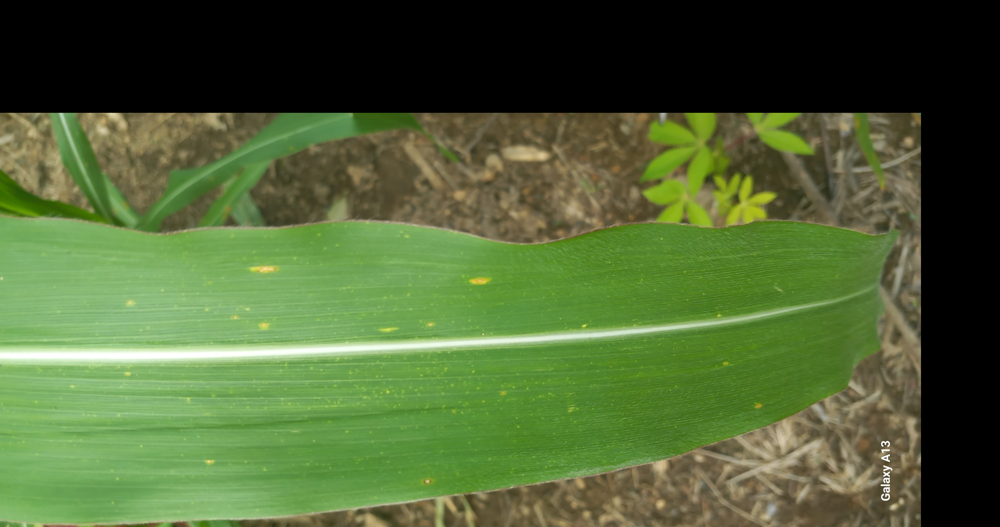

In [23]:
# Define padding function
# Use this tutorial as a guide:
# https://note.nkmk.me/en/python-pillow-add-margin-expand-canvas/
def pad_img(im,top, right, bottom =0, left = 0, color = (0,0,0)):

    photo = Image.open(im)
    size = photo.size
    new_width = size[0] + right + left
    new_height = size[1] + top + bottom
    result = Image.new(photo.mode, (new_width, new_height), color)
    result.paste(photo, (left, top))
    return result
# Test out function
pad_img(no_duplicates['img_path'][0],500,350)